#### Import libraries & set-up holidays

In [5]:
import pandas as pd
import numpy as np
#import tiingo
import requests
from tqdm import tqdm
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
from pandas.tseries.offsets import MonthBegin
from pandas.tseries.offsets import MonthEnd
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly

## Create holiday calendar
cal = calendar()

holidays = cal.holidays(start='2000-01-01',
                        end='2030-12-30')

holiday_df = pd.DataFrame(data=holidays,
                          columns = ['date']).assign(holiday='USFederalHoliday')

holiday_df.rename(columns={'date':'ds'},inplace=True)
#holiday_df.to_csv('us_holidays_until_2030.csv')

In [6]:
## The full data for the 5 minute chart is 120k rows starting from late 2016, it takes 5 minutes to train the prophet model and a minute to make the forecast
## for the 15 min chart is 41k row and runs for 1min30sec, 1 hour is 10k rows and runs for 25 secs

#### Connect to tiingo

In [7]:
# 15min to # 1h 
headers = {
    'Content-Type': 'application/json'
}
requestResponse = requests.get("https://api.tiingo.com/iex/SPY/prices?startDate=2015-01-02&endDate=2022-12-31&resampleFreq=5min&columns=open,high,low,close,volume&token=0ed744c7db5ef348139953912e2f3cee79f4608b", headers=headers)
#print(requestResponse.json())

In [40]:
## The earliest Tiingo 5 min data for SPY starts from 2016-12-01 
ticker = 'SPY'
tiingo_time_interval = '15min'
## Tiingo time intervals accepted = 5min, 15min, 30min, 1hour, 4hour
start_date_first_month_extract = '12/1/2016'
start_date_current_month = (pd.to_datetime('now') - MonthBegin(1)).strftime('%m-%d-%Y') 
end_date_current_month = (pd.to_datetime('now') + MonthEnd(1)).strftime('%m-%d-%Y') 

# Generate month_start and month end arrays to use for looping over and getting data month by month
# Freq MS generates month start and freq M generates month end
month_start_date  = pd.date_range(start = start_date_first_month_extract,
                                  end = start_date_current_month,
                                  freq = 'MS').strftime('%Y-%m-%d')
month_end_date  = pd.date_range(start = start_date_first_month_extract, 
                                end = end_date_current_month, 
                                freq ='M').strftime('%Y-%m-%d')
print("the size of the monthly data is " + str(month_end_date.size))


# Below loop gets data for each month on a given interval level for a given ticker

total_df = pd.DataFrame()
for x in tqdm(range(month_start_date.size)):
    month_start = month_start_date[x]
    month_end  = month_end_date[x]
    requestResponse = requests.get("https://api.tiingo.com/iex/"+str(ticker)+"/prices?startDate="+str(month_start)+"&endDate="+str(month_end)+"&resampleFreq="+str(tiingo_time_interval)+"&columns=open,high,low,close,volume&token=0ed744c7db5ef348139953912e2f3cee79f4608b", headers=headers)
    #print(x) 
    #print("https://api.tiingo.com/iex/SPY/prices?startDate="+str(month_start)+"&endDate="+str(month_end)+"&resampleFreq=5min&columns=open,high,low,close,volume&token=0ed744c7db5ef348139953912e2f3cee79f4608b") 
    df_stock = pd.DataFrame(requestResponse.json()) 

    total_df = total_df.append(df_stock)

print('Data download done for the ticker '+str(ticker)+' with a earliest date ' +str(total_df.date.min())+' and latest date '+str(total_df.date.max()))
total_df.to_csv('spy_5_min_all_data.csv')

  0%|          | 0/73 [00:00<?, ?it/s]

the size of the monthly data is 73


100%|██████████| 73/73 [00:46<00:00,  1.57it/s]


Data download done for the ticker SPY with a earliest date 2016-12-12T14:30:00.000Z and latest date 2022-12-05T21:00:00.000Z


In [41]:
df_stock = total_df
df_stock.date = pd.to_datetime(df_stock.date)

## Remove the US public holidays
df_stock = df_stock[~df_stock.date.dt.date.isin(holiday_df.ds)]
df_stock.dtypes

c:\Users\IvanIvanov\Anaconda3\lib\site-packages\pandas\core\algorithms.py:524: FutureWarning:

Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.



date      datetime64[ns, UTC]
open                  float64
high                  float64
low                   float64
close                 float64
volume                float64
dtype: object

In [42]:
df_stock.rename(columns={"date": "ds", "close": "y"},inplace=True)
df_stock.ds = df_stock.ds.dt.tz_convert(None)
df_stock.ds.dt.day_name().value_counts()

Thursday     8422
Tuesday      8397
Wednesday    8396
Friday       8358
Monday       8316
Name: ds, dtype: int64

In [43]:
df_stock.ds.dt.hour.value_counts()


15    6208
16    6208
17    6208
18    6205
19    6204
14    5136
20    3155
13    2032
21     533
Name: ds, dtype: int64

In [44]:
print(df_stock.shape)
df_stock.ds.dt.hour.value_counts()
mask = np.logical_and(df_stock.ds.dt.hour >= 13,
                      df_stock.ds.dt.hour <= 20)
df_stock = df_stock[mask]
df_stock = df_stock.sort_values('ds',  ascending=True)
df_stock.reset_index(drop=True,inplace=True)
print(df_stock.shape)

(41889, 6)
(41356, 6)


In [45]:
df_stock

,ds,open,high,low,y,volume
0,2016-12-12 14:30:00,226.400,226.580,226.255,226.425,68394.0
1,2016-12-12 14:45:00,226.430,226.820,226.395,226.820,33376.0
2,2016-12-12 15:00:00,226.820,226.960,226.530,226.545,34345.0
3,2016-12-12 15:15:00,226.545,226.570,226.215,226.220,21309.0
4,2016-12-12 15:30:00,226.215,226.495,226.195,226.335,22334.0
...,...,...,...,...,...,...
41351,2022-12-05 19:45:00,398.575,399.055,398.175,398.930,53948.0
41352,2022-12-05 20:00:00,398.925,399.495,398.660,399.425,59111.0
41353,2022-12-05 20:15:00,399.430,399.500,398.620,398.720,55812.0
41354,2022-12-05 20:30:00,398.685,399.660,398.665,399.115,139735.0


#### Prophet

In [14]:
# Python
m = Prophet(holidays=holiday_df, growth = 'linear')
# m = Prophet(holidays=holiday_df, growth = 'linear')
m.fit(df_stock[['ds','y']])

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:finish chain 1


In [15]:
# Python
future = m.make_future_dataframe(periods=150,freq="15min")
future.tail()

,ds
41501,2022-12-07 09:15:00
41502,2022-12-07 09:30:00
41503,2022-12-07 09:45:00
41504,2022-12-07 10:00:00
41505,2022-12-07 10:15:00


In [16]:
mask = np.logical_and(future.ds.dt.hour >= 13,
                      future.ds.dt.hour <= 20)
future = future[mask]
future = future.sort_values('ds',  ascending=True)
future.reset_index(drop=True,inplace=True)
future.shape

(41388, 1)

#### Prediction results

In [17]:
# Python
forecast = m.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(60)

,ds,yhat,yhat_lower,yhat_upper
41328,2022-12-02 20:30:00,393.104905,382.011422,404.319401
41329,2022-12-02 20:45:00,393.086201,381.107136,404.394087
41330,2022-12-05 14:30:00,392.445551,381.512749,404.203194
41331,2022-12-05 14:45:00,392.436275,381.154834,403.648864
41332,2022-12-05 15:00:00,392.428860,381.654826,403.553778
41333,2022-12-05 15:15:00,392.424148,380.637328,404.315872
41334,2022-12-05 15:30:00,392.422145,381.621439,403.473817
41335,2022-12-05 15:45:00,392.422269,380.296212,403.300798
41336,2022-12-05 16:00:00,392.423612,381.218842,403.209754
41337,2022-12-05 16:15:00,392.425179,382.052104,404.092414


In [18]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(150)

,ds,yhat,yhat_lower,yhat_upper
41238,2022-11-29 17:30:00,393.562131,382.475176,405.541540
41239,2022-11-29 17:45:00,393.563818,382.678337,404.769763
41240,2022-11-29 18:00:00,393.565742,382.120786,404.231083
41241,2022-11-29 18:15:00,393.568485,382.234928,405.709892
41242,2022-11-29 18:30:00,393.572373,382.078578,405.002763
...,...,...,...,...
41383,2022-12-06 19:45:00,392.569138,381.451379,403.716378
41384,2022-12-06 20:00:00,392.563276,380.945021,404.070630
41385,2022-12-06 20:15:00,392.552465,381.339281,403.385634
41386,2022-12-06 20:30:00,392.536697,381.680617,402.943850


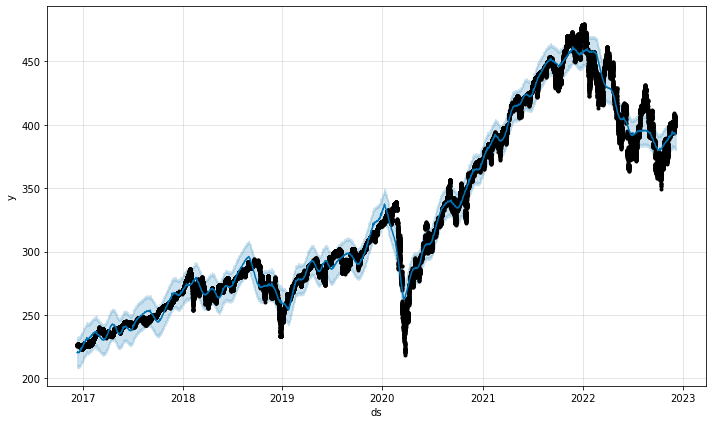

In [19]:
# Python
fig1 = m.plot(forecast)

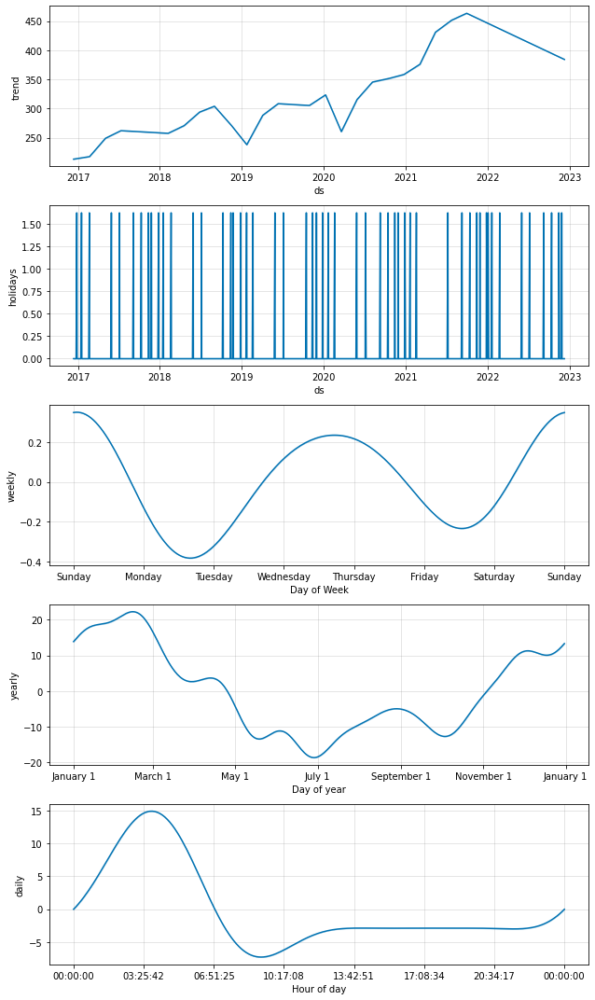

In [20]:
# Python
fig2 = m.plot_components(forecast)

In [21]:
# Python
plot_plotly(m, forecast)

In [22]:
# Python
plot_components_plotly(m, forecast)

#### Appendix

In [23]:
#### Test the earleist data available for give ticker

# ticker = 'SPY'

# x = 77


# # Generate month_start and month end to use for looping over and getting data month by month
# month_start_date  = pd.date_range(start='12/1/2010', end='12/1/2022', freq='MS').strftime('%Y-%m-%d')
# month_end_date  = pd.date_range(start='12/1/2010', end='12/31/2022', freq='M').strftime('%Y-%m-%d')
# print("the size of the monthly data is " + str(month_end_date.size))


# month_start = month_start_date[x]
# month_end = month_start_date[x]

# print(month_start_date[x])


# requestResponse = requests.get("https://api.tiingo.com/iex/"+str(ticker)+"/prices?startDate="+str(month_start)+"&endDate="+str(month_end)+"&resampleFreq=15min&columns=open,high,low,close,volume&token=0ed744c7db5ef348139953912e2f3cee79f4608b", headers=headers)
# print(x) 
# #print("https://api.tiingo.com/iex/SPY/prices?startDate="+str(month_start)+"&endDate="+str(month_end)+"&resampleFreq=5min&columns=open,high,low,close,volume&token=0ed744c7db5ef348139953912e2f3cee79f4608b") 
# df_stock = pd.DataFrame(requestResponse.json()) 
# df_stock


In [24]:
# import xgboost as xgb 
# clf_xgb = xgb.XGBRegressor(objective='reg:squarederror', 
#                             tree_method = 'gpu_hist',
#                             gamma = 0.5,
#                            max_depth = 25,
#                             seed=42,
#                             n_estimators=30)

In [25]:
# clf_xgb.fit(X_train,
#             y_train,
#            verbose=True,
#             early_stopping_rounds=20,
#             eval_metric='rmse',   #aucpr,auc, map
#             eval_set=[(X_test,y_test)])